# Financial Well-Being Project: Data Analysis

This notebook was created to further analyze the 2nd dataset by excluding financial variables that were appeared in the first 3 layers of multiple decision trees. The goal was to focus on non-financial factors and see the impact of removing them.

Variables excluded:
* PPINCIMP - Annual household income
* fpl - Federal Poverty Level
* SNAP_1, SNAP_2, SNAP_8 - Receipt of benefits from the Food Stamp Program or SNAP (the Supplemental Nutrition Assistance Program) by any household member

In [1]:
# Import dependencies
import pandas as pd
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
from pprint import pprint

# Preparing and scaling data
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Machine learning models and optimizers
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier

# Metrics for model evaluation
from sklearn.metrics import mean_squared_error, r2_score, confusion_matrix, accuracy_score, classification_report

## Load Preprocessed Data

In [2]:
# Set path for CSV file
path = Path('data/fwb_processed_data_2.csv')
# path = Path('resources/NFWBS_PUF_2016_data.csv')

# Load preprocessed data
data_df = pd.read_csv(path, index_col=0)

# Display shape and sample data
print(f'Dataframe shape: {data_df.shape}')
data_df.head()

Dataframe shape: (5931, 114)


,PPEDUC,agecat,HEALTH,PPGENDER,HOUSESAT,KIDS_1,KIDS_2,KIDS_3,KIDS_3.1,fpl,...,PPREG4_4,PPREG9_1,PPREG9_2,PPREG9_3,PPREG9_4,PPREG9_5,PPREG9_6,PPREG9_7,PPREG9_8,PPREG9_9
PUF_ID,,,,,,,,,,,,,,,,,,,,,
10350,4,8,2,1,4,0,0,0,0,3,...,1,0,0,0,0,0,0,0,1,0
7740,2,3,3,1,3,0,0,0,0,3,...,0,0,0,1,0,0,0,0,0,0
13699,3,3,3,1,3,0,0,0,0,3,...,1,0,0,0,0,0,0,0,0,1
7375,2,2,3,1,3,0,0,0,0,3,...,0,0,0,0,1,0,0,0,0,0
10910,4,2,5,1,4,0,0,0,0,3,...,0,0,0,1,0,0,0,0,0,0


In [3]:
# Drop household income
data_df.drop(columns=['PPINCIMP', 'fpl', 'SNAP_0', 'SNAP_1', 'SNAP_8'], inplace=True)

## Model Definitions and Functions

In [4]:
# Define features set
X = data_df.copy()
X.drop(columns=['FWBscore', 'FWBscore_wt'], axis=1, inplace=True)
X.head()

,PPEDUC,agecat,HEALTH,PPGENDER,HOUSESAT,KIDS_1,KIDS_2,KIDS_3,KIDS_3.1,EMPLOY1_1,...,PPREG4_4,PPREG9_1,PPREG9_2,PPREG9_3,PPREG9_4,PPREG9_5,PPREG9_6,PPREG9_7,PPREG9_8,PPREG9_9
PUF_ID,,,,,,,,,,,,,,,,,,,,,
10350,4,8,2,1,4,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
7740,2,3,3,1,3,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
13699,3,3,3,1,3,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
7375,2,2,3,1,3,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
10910,4,2,5,1,4,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


In [5]:
# Define target
y = data_df['FWBscore'].values.reshape(-1, 1)
y[:5]

array([[55],
       [51],
       [49],
       [49],
       [67]], dtype=int64)

In [6]:
# Function to evaluate model using confusion matrix and classification report
def eval_model_cmcr():
    # Calculating the confusion matrix
    index = ['Actual ' + label for label in class_labels]
    columns = ['Predicted ' + label for label in class_labels]

    cm = confusion_matrix(y_test, predictions)
    cm_df = pd.DataFrame(
        cm, index=index,
        columns=columns
    )

    # Calculating the accuracy score
    acc_score = accuracy_score(y_test, predictions)
    
    # Displaying results
    print("Confusion Matrix")
    display(cm_df)
    print(f"Accuracy Score : {acc_score}")
    print("Classification Report")
    print(classification_report(y_test, predictions))
    return round(acc_score, 3)

In [7]:
# Function to split up and classify target based on percentiles
def classify_y(num, labels):
    y = pd.qcut(data_df['FWBscore'], num, labels=labels)
    y = y.ravel()
    print(y[:5])
    return y

In [8]:
# Function to plot a decision tree
def plot_d_tree(model, acc_score, i, num_classes, figsize):
    
    # Configure plot
    fig, axes = plt.subplots(nrows=1, ncols=1, figsize=figsize, dpi=600)
    
    # Plot tree
    plot_tree(model, feature_names=feature_names, class_names=class_labels, filled=True)
    title = f'Decision Tree Model #{i+1} with {num_classes} Classes\nAccuracy Score:{acc_score}'
    axes.set_title(title, fontsize = 11)
    
    # Save tree
    plt.savefig(f'images/dataset_3/dt_{num_classes}c_{i+1}.png')

In [9]:
# Function to plot first 4 trees in a random forest
# Code ref: https://stackoverflow.com/questions/40155128/plot-trees-for-a-random-forest-in-python-with-scikit-learn
def plot_r_forest(model, acc_score, i, num_classes, figsize):
    
    # Configure plot
    fig, axes = plt.subplots(nrows=4, ncols=1, figsize=figsize, dpi=600)
    for index in range(0, 4):
        plot_tree(model.estimators_[index],
                       feature_names = feature_names, 
                       class_names=class_labels,
                       filled = True,
                       ax = axes[index])
        if index == 0:
            title = f'Randon Forest Model #{i+1} with {num_classes} Classes\nEstimator: {index}, Accuracy Score:{acc_score}'
        else:
            title = f'Estimator: {index}'
        axes[index].set_title(title, fontsize = 11)
    
    # Save tree
    plt.savefig(f'images/dataset_3/rf_{num_classes}c_{i+1}.png')

## Linear Regression Model

In [10]:
# Create a model with scikit-learn
model_lr = LinearRegression()

### Fit the model and make predictions

In [11]:
# Fit the data into the model
model_lr.fit(X, y)

LinearRegression()

In [12]:
# Make predictions using the X set
predicted_y_values = model_lr.predict(X)

# Create a copy of the original data
predicted_df = data_df.copy()

# Add a column with the predicted salary values
predicted_df["predicted_FWBscore"] = predicted_y_values

# Display sample data
predicted_df

,PPEDUC,agecat,HEALTH,PPGENDER,HOUSESAT,KIDS_1,KIDS_2,KIDS_3,KIDS_3.1,EMPLOY1_1,...,PPREG9_1,PPREG9_2,PPREG9_3,PPREG9_4,PPREG9_5,PPREG9_6,PPREG9_7,PPREG9_8,PPREG9_9,predicted_FWBscore
PUF_ID,,,,,,,,,,,,,,,,,,,,,
10350,4,8,2,1,4,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,56.820190
7740,2,3,3,1,3,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,55.059692
13699,3,3,3,1,3,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,49.285767
7375,2,2,3,1,3,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,48.505981
10910,4,2,5,1,4,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,60.891357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11220,5,7,5,2,4,0,0,1,1,0,...,0,0,1,0,0,0,0,0,0,62.906860
13118,2,6,4,1,4,1,0,2,2,0,...,0,0,0,0,0,1,0,0,0,69.470337
8709,5,2,3,2,3,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,55.875854


### Evaluate the model

In [13]:
# Compute metrics for the linear regression model: score, r2, mse, rmse, std
score = model_lr.score(X, y, sample_weight=None)
r2 = r2_score(y, predicted_y_values)
mse = mean_squared_error(y, predicted_y_values)
rmse = np.sqrt(mse)
std = np.std(y)

# Print relevant metrics.
print(f"The score is {score}.")
print(f"The r2 is {r2}.")
print(f"The mean squared error is {mse}.")
print(f"The root mean squared error is {rmse}.")
print(f"The standard deviation is {std}.")

The score is 0.5171696304493606.
The r2 is 0.5171696304493606.
The mean squared error is 94.24401789031329.
The root mean squared error is 9.707935820261344.
The standard deviation is 13.971068018615613.


## Decision Tree with 3 Target Classes

### Setup and scale data

In [14]:
# Display quartiles for cutting
data_df['FWBscore'].quantile([.25, .5, .75])

0.25    48.0
0.50    56.0
0.75    65.0
Name: FWBscore, dtype: float64

In [15]:
# Create 3 target classes
num_classes = 3
class_labels = ['<Avg', 'Avg', '>Avg']
y = classify_y(num_classes, class_labels)

['Avg', 'Avg', '<Avg', '<Avg', '>Avg']
Categories (3, object): ['<Avg' < 'Avg' < '>Avg']


In [16]:
# Splitting into Train and Test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=78)

### Determine the best set of hyperparameters

In [17]:
parameters = {'max_depth': [3, 5, 7, 9, 10, 25],
              'max_features': ['sqrt', 'log2', None],
              'min_samples_split': [2, 4, 6, 10, 20, 30],
              'min_samples_leaf': [1, 2, 5, 8, 10, 20] 
             }

In [18]:
# Create the decision tree classifier instance
model_dt = RandomizedSearchCV(DecisionTreeClassifier(),param_distributions = parameters, cv = 20, verbose = True)

In [19]:
# Fit the model
model_dt = model_dt.fit(X_train, y_train)

Fitting 20 folds for each of 10 candidates, totalling 200 fits


In [20]:
model_dt.best_estimator_

DecisionTreeClassifier(max_depth=5, min_samples_split=4)

### Fit, Predict and Evaluate Model

In [21]:
# Create list to store decision tree classifier instances
model_dt3c = []

# DT Model #1: Default settings
model_dt3c.append(DecisionTreeClassifier(max_depth=None, max_features=None, min_samples_split=2, min_samples_leaf=1))

# DT Model #1: Simple tree
model_dt3c.append(DecisionTreeClassifier(max_depth=4, max_features=None, min_samples_split=5, min_samples_leaf=3))  

# DT Model #3: Best results after testing
model_dt3c.append(DecisionTreeClassifier(max_depth=5, max_features=None, min_samples_split=10, min_samples_leaf=5))                 
                  
# DT Model #4: Best estimator from RandomizedSearchCV
model_dt3c.append(DecisionTreeClassifier(max_depth=7, max_features=None, min_samples_split=20, min_samples_leaf=10))

In [22]:
# Create list to store accurancy scores
acc_score_dt3c = []

# Loop to Fit, predict and evaluate models
for i in range(0, len(model_dt3c)):
    model = model_dt3c[i]           
               
    # Fit the model
    model = model.fit(X_train, y_train)

    # Make predictions using the testing data
    predictions = model.predict(X_test)
    
    # Evaluate the model and store accuracy score
    print(f'Evaluation of Model #{i+1}\n')
    acc_score = eval_model_cmcr()
    acc_score_dt3c.append(acc_score)

Evaluation of Model #1

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,270,83,154
Actual Avg,57,252,164
Actual >Avg,143,153,207


Accuracy Score : 0.4915711395819285
Classification Report
              precision    recall  f1-score   support

        <Avg       0.57      0.53      0.55       507
        >Avg       0.52      0.53      0.52       473
         Avg       0.39      0.41      0.40       503

    accuracy                           0.49      1483
   macro avg       0.50      0.49      0.49      1483
weighted avg       0.49      0.49      0.49      1483

Evaluation of Model #2

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,272,50,185
Actual Avg,37,266,170
Actual >Avg,111,147,245


Accuracy Score : 0.5279838165879973
Classification Report
              precision    recall  f1-score   support

        <Avg       0.65      0.54      0.59       507
        >Avg       0.57      0.56      0.57       473
         Avg       0.41      0.49      0.44       503

    accuracy                           0.53      1483
   macro avg       0.54      0.53      0.53      1483
weighted avg       0.54      0.53      0.53      1483

Evaluation of Model #3

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,308,59,140
Actual Avg,44,286,143
Actual >Avg,146,171,186


Accuracy Score : 0.5259608900876601
Classification Report
              precision    recall  f1-score   support

        <Avg       0.62      0.61      0.61       507
        >Avg       0.55      0.60      0.58       473
         Avg       0.40      0.37      0.38       503

    accuracy                           0.53      1483
   macro avg       0.52      0.53      0.52      1483
weighted avg       0.52      0.53      0.52      1483

Evaluation of Model #4

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,308,58,141
Actual Avg,39,285,149
Actual >Avg,144,139,220


Accuracy Score : 0.5482130815913688
Classification Report
              precision    recall  f1-score   support

        <Avg       0.63      0.61      0.62       507
        >Avg       0.59      0.60      0.60       473
         Avg       0.43      0.44      0.43       503

    accuracy                           0.55      1483
   macro avg       0.55      0.55      0.55      1483
weighted avg       0.55      0.55      0.55      1483



### Plot and Save Decision Trees

In [23]:
feature_names = list(X.columns)
figsize = (15, 5)

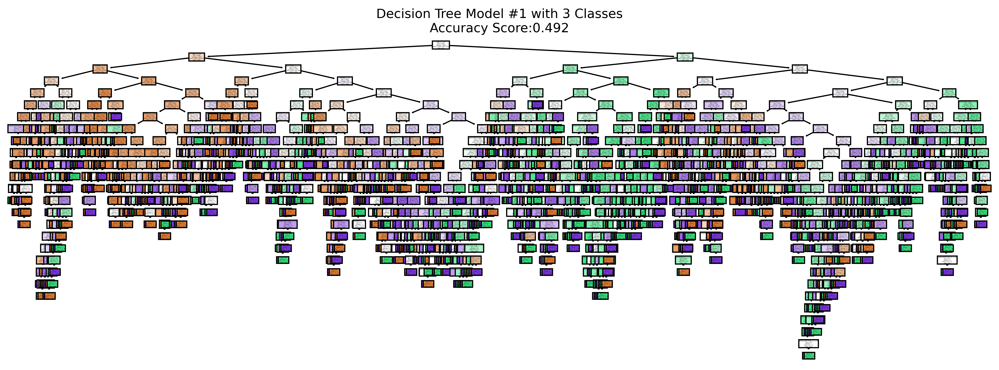

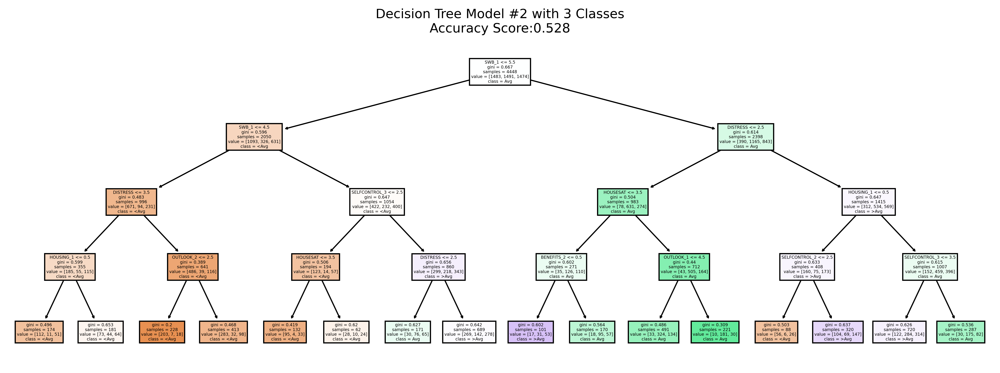

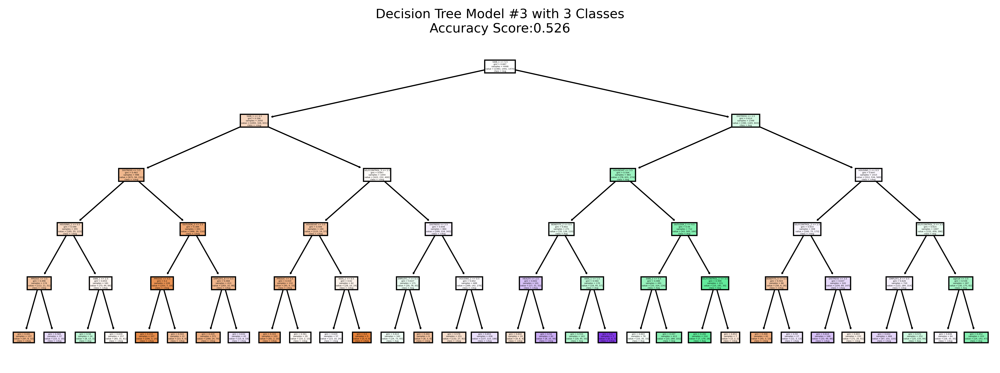

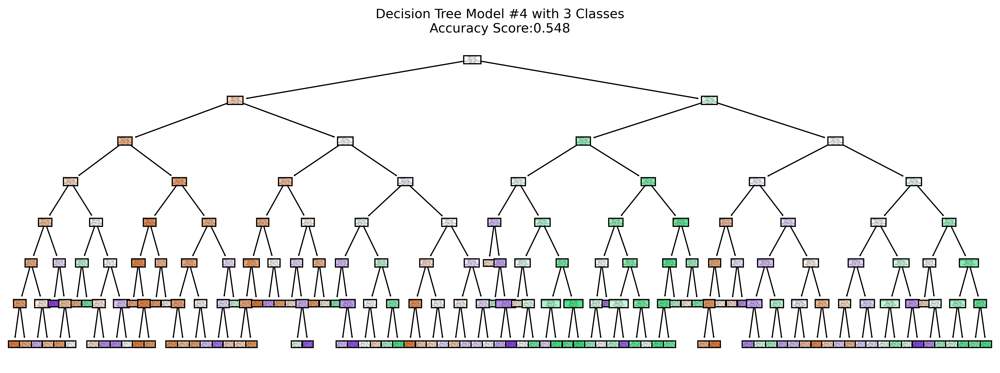

In [24]:
# Plot trees for each model
for i in range(0, len(model_dt3c)):
    plot_d_tree(model_dt3c[i], acc_score_dt3c[i], i, num_classes, figsize)

In [25]:
# Plot one tree - Use to adjust figsize or testing one model
# see dt_3c_1_resized for resized model#1
i = 0
num_classes = 3
figsize=(47, 8)

# plot_d_tree(model_dt3c[i], acc_score_dt3c[i], i, num_classes, figsize)

## Random Forest with 3 Target Classes

### Determine the best set of hyperparameters

In [26]:
# Create random grid with parameters
# Resource: https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74

parameters = {'n_estimators': [200, 250, 300, 500, 800, 1000, 1500, 2000],
               'max_depth': [5, 8, 10, 15, 20, 50],
               'min_samples_split': [2, 3, 5, 7, 10, 20],
               'min_samples_leaf': [1, 2, 4, 6],
               'bootstrap': [True, False]
             }

In [27]:
# Create the RF classifier instance
model_rf = RandomizedSearchCV(RandomForestClassifier(), param_distributions = parameters, cv = 5, verbose = True)

In [28]:
# Fit the model
model_rf = model_rf.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [29]:
model_rf.best_estimator_

RandomForestClassifier(max_depth=20, min_samples_leaf=4, min_samples_split=7,
                       n_estimators=800)

### Fit, Predict and Evaluate Model

In [30]:
# Create list to store decision tree classifier instances
model_rf3c = []

# RF Model #1 
model_rf3c.append(RandomForestClassifier(n_estimators=200, random_state=78, bootstrap=True,
                                         max_depth=5, min_samples_split=2, min_samples_leaf=1))

# RF Model #2
model_rf3c.append(RandomForestClassifier(n_estimators=600, random_state=78, bootstrap=False,
                                         max_depth=10, min_samples_split=5, min_samples_leaf=3))                 
                  
# RF Model #3: One of the best estimators from RandomizedSearchCV
model_rf3c.append(RandomForestClassifier(n_estimators=250, random_state=78, bootstrap=False,
                                         max_depth=10, min_samples_split=7, min_samples_leaf=2))

In [31]:
# Create list to store accurancy scores
acc_score_rf3c = []

# Loop to fit, predict and evaluate models
for i in range(0, len(model_rf3c)):
    model = model_rf3c[i]           
               
    # Fit the model
    model = model.fit(X_train, y_train)

    # Make predictions using the testing data
    predictions = model.predict(X_test)
    
    # Evaluate the model and save accuracy score
    print(f'Evaluation of Model #{i+1}\n')
    acc_score = eval_model_cmcr()
    acc_score_rf3c.append(acc_score)

Evaluation of Model #1

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,364,52,91
Actual Avg,35,361,77
Actual >Avg,159,198,146


Accuracy Score : 0.5873229939312204
Classification Report
              precision    recall  f1-score   support

        <Avg       0.65      0.72      0.68       507
        >Avg       0.59      0.76      0.67       473
         Avg       0.46      0.29      0.36       503

    accuracy                           0.59      1483
   macro avg       0.57      0.59      0.57      1483
weighted avg       0.57      0.59      0.57      1483

Evaluation of Model #2

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,362,40,105
Actual Avg,28,338,107
Actual >Avg,132,177,194


Accuracy Score : 0.602832097100472
Classification Report
              precision    recall  f1-score   support

        <Avg       0.69      0.71      0.70       507
        >Avg       0.61      0.71      0.66       473
         Avg       0.48      0.39      0.43       503

    accuracy                           0.60      1483
   macro avg       0.59      0.60      0.60      1483
weighted avg       0.59      0.60      0.60      1483

Evaluation of Model #3

Confusion Matrix


,Predicted <Avg,Predicted Avg,Predicted >Avg
Actual <Avg,359,42,106
Actual Avg,27,344,102
Actual >Avg,137,172,194


Accuracy Score : 0.6048550236008091
Classification Report
              precision    recall  f1-score   support

        <Avg       0.69      0.71      0.70       507
        >Avg       0.62      0.73      0.67       473
         Avg       0.48      0.39      0.43       503

    accuracy                           0.60      1483
   macro avg       0.60      0.61      0.60      1483
weighted avg       0.59      0.60      0.60      1483



### Plot and Save Images of Sample Trees

In [32]:
feature_names = list(X.columns)
figsize = (20, 20)

In [33]:
# Plot 4 trees for each forest - Use to adjust figsize or test one model
for i in range(0, len(model_rf3c)):
    plot_r_forest(model_rf3c[i], acc_score_rf3c[i], i, num_classes, figsize)

In [34]:
# Plot 4 trees for one forest - Use to adjust figsize or test one model
i = 2
num_classes = 3
figsize = (40, 40)

# plot_r_forest(model_rf3c[i], acc_score_rf3c[i], i, num_classes, figsize)

In [35]:
# Random Forests in sklearn will automatically calculate feature importance
# Loop through models to display features sorted by importance hight to low
for i in range(0, len(model_rf3c)):
    model = model_rf3c[i]
    importances = model.feature_importances_
    
    # Sort features by their importance for current model
    pprint(f'Feature importance for model #{i+1}')
    pprint(sorted(zip(model.feature_importances_[0:15], X.columns[0:15]), reverse=True))
    print('\n')

'Feature importance for model #1'
[(0.09043797851518402, 'HOUSESAT'),
 (0.04007859862670173, 'agecat'),
 (0.03505669934263084, 'HEALTH'),
 (0.018050558667417064, 'PPEDUC'),
 (0.0021829000488492634, 'KIDS_3.1'),
 (0.0021623427685973865, 'EMPLOY1_6'),
 (0.00197383386188536, 'KIDS_2'),
 (0.0016483477761242138, 'KIDS_3'),
 (0.001418503864928179, 'EMPLOY1_2'),
 (0.0011497327937907394, 'EMPLOY1_4'),
 (0.0010312854867600158, 'KIDS_1'),
 (0.0008455480732325197, 'PPGENDER'),
 (0.0004979522553735185, 'EMPLOY1_1'),
 (0.0004645625512602819, 'EMPLOY1_3'),
 (0.00041505523827748135, 'EMPLOY1_5')]


'Feature importance for model #2'
[(0.05801894351469026, 'HOUSESAT'),
 (0.03601313726249142, 'agecat'),
 (0.026428876355282547, 'HEALTH'),
 (0.023730702341091096, 'PPEDUC'),
 (0.005804315924970495, 'PPGENDER'),
 (0.0049547916702157475, 'EMPLOY1_2'),
 (0.0043315822524641985, 'KIDS_2'),
 (0.0029821434134977213, 'KIDS_1'),
 (0.0028528215007625627, 'KIDS_3'),
 (0.002727537871552876, 'KIDS_3.1'),
 (0.0021835331